In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import sqlite3
import os
from math import ceil

# Initial Data Exploration

In [2]:
data = pd.read_csv(r'C:\Users\sacar\Downloads\DM2425_ABCDEats_DATASET.csv')
data.head(10)

,customer_id,customer_region,customer_age,vendor_count,product_count,is_chain,first_order,last_order,last_promo,payment_method,...,HR_14,HR_15,HR_16,HR_17,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23
0,1b8f824d5e,2360,18.0,2,5,1,0.0,1,DELIVERY,DIGI,...,0,0,0,0,2,0,0,0,0,0
1,5d272b9dcb,8670,17.0,2,2,2,0.0,1,DISCOUNT,DIGI,...,0,0,0,0,0,0,0,0,0,0
2,f6d1b2ba63,4660,38.0,1,2,2,0.0,1,DISCOUNT,CASH,...,0,0,0,0,0,0,0,0,0,0
3,180c632ed8,4660,NaN,2,3,1,0.0,2,DELIVERY,DIGI,...,1,0,0,0,0,0,0,0,0,0
4,4eb37a6705,4660,20.0,2,5,0,0.0,2,-,DIGI,...,0,0,0,0,0,0,0,0,0,0
5,6aef2b6726,8670,40.0,2,2,0,0.0,2,FREEBIE,DIGI,...,0,0,0,0,0,0,0,0,0,0
6,8475ee66ef,2440,24.0,2,2,2,0.0,2,-,CARD,...,0,0,0,1,0,0,0,0,0,0
7,f2f53bcc67,8670,27.0,2,3,2,0.0,2,DISCOUNT,DIGI,...,0,1,0,0,0,0,0,0,0,0
8,5b650c89cc,2360,20.0,3,4,2,0.0,3,DISCOUNT,DIGI,...,0,0,0,1,0,1,0,0,0,1
9,84775a7237,8670,20.0,2,3,0,0.0,3,DELIVERY,CARD,...,0,0,0,0,0,0,0,0,0,0


In [3]:
data.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 31888 entries, 0 to 31887
Data columns (total 56 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   customer_id               31888 non-null  object 
 1   customer_region           31888 non-null  object 
 2   customer_age              31161 non-null  float64
 3   vendor_count              31888 non-null  int64  
 4   product_count             31888 non-null  int64  
 5   is_chain                  31888 non-null  int64  
 6   first_order               31782 non-null  float64
 7   last_order                31888 non-null  int64  
 8   last_promo                31888 non-null  object 
 9   payment_method            31888 non-null  object 
 10  CUI_American              31888 non-null  float64
 11  CUI_Asian                 31888 non-null  float64
 12  CUI_Beverages             31888 non-null  float64
 13  CUI_Cafe                  31888 non-null  float64
 14  CUI_Ch

In [4]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
customer_age,31161.0,27.506499,7.160898,15.0,23.0,26.0,31.00,80.00
vendor_count,31888.0,3.102609,2.771587,0.0,1.0,2.0,4.00,41.00
product_count,31888.0,5.668245,6.957287,0.0,2.0,3.0,7.00,269.00
is_chain,31888.0,2.818866,3.977529,0.0,1.0,2.0,3.00,83.00
first_order,31782.0,28.478604,24.109086,0.0,7.0,22.0,45.00,90.00
last_order,31888.0,63.675521,23.226123,0.0,49.0,70.0,83.00,90.00
CUI_American,31888.0,4.880438,11.654018,0.0,0.0,0.0,5.66,280.21
CUI_Asian,31888.0,9.960451,23.564351,0.0,0.0,0.0,11.83,896.71
CUI_Beverages,31888.0,2.300633,8.479734,0.0,0.0,0.0,0.00,229.22
CUI_Cafe,31888.0,0.801163,6.427132,0.0,0.0,0.0,0.00,326.10


# Missing Values, Data Types, Duplicates

In [5]:
#Check for duplicates and drop them.

#count the number of duplicates
data.duplicated().sum() 

#drop duplicates from the data
data.drop_duplicates(inplace=True) #duplicates dropped - do we need to include what the duplicates were?

In [6]:
#Fix data types

#Convert customer age from float to int
data['customer_age'] = data['customer_age'].astype("int")

#Convert first_order from float to int
data['first_order'] = data['first_order'].astype("int")

#Convert HR_0 from float to int
HR_0 -> int data['HR_0'] = data['HR_o'].astype("int")

SyntaxError: invalid syntax (1127744522.py, line 10)

In [7]:
#NA values

#Replace empty strings with nan
data.replace("", np.nan, inplace=True)

#count the number of nans
data.isna().sum()

customer_id                    0
customer_region                0
customer_age                 727
vendor_count                   0
product_count                  0
is_chain                       0
first_order                  106
last_order                     0
last_promo                     0
payment_method                 0
CUI_American                   0
CUI_Asian                      0
CUI_Beverages                  0
CUI_Cafe                       0
CUI_Chicken Dishes             0
CUI_Chinese                    0
CUI_Desserts                   0
CUI_Healthy                    0
CUI_Indian                     0
CUI_Italian                    0
CUI_Japanese                   0
CUI_Noodle Dishes              0
CUI_OTHER                      0
CUI_Street Food / Snacks       0
CUI_Thai                       0
DOW_0                          0
DOW_1                          0
DOW_2                          0
DOW_3                          0
DOW_4                          0
DOW_5     

# Handle Missing Values

## NANs Identified
- **customer_age**
- **first_order**
- **HR_0**

## Suggestions to Handle NANs
1. **customer_age**  
   Fill with median.

2. **first_order**  
   Fill with median.

3. **HR_0**  
   Can we calculate by:  
   `sum(DOW_columns) - sum(HR_columns)`?


# Visual Data Exploration

In [18]:
#split data into metric and non_metric features
non_metric_features = ["customer_id", "customer_region", "last_promo", "payment_method"]
metric_features = data.columns.drop(non_metric_features).tolist()

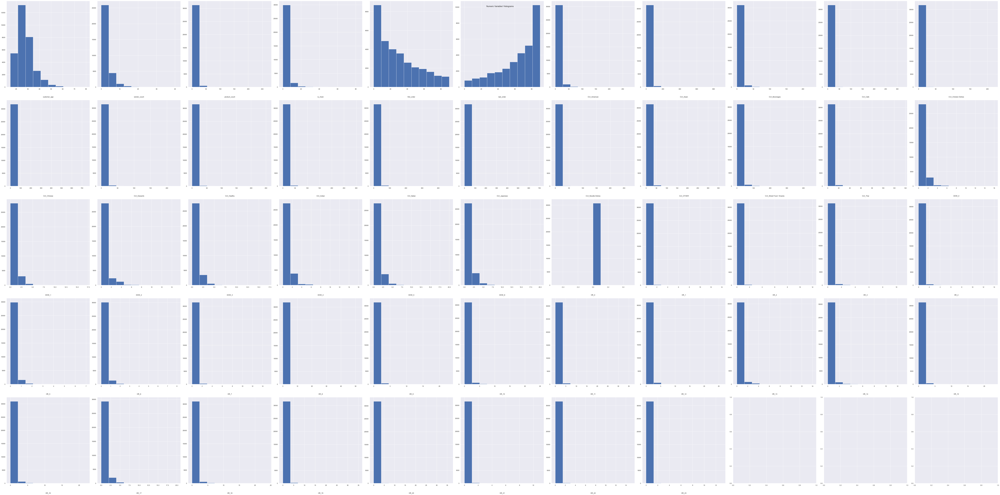

In [11]:

# Plot ALL Numeric Variables' Histograms in one figure

sns.set() ## Reset to darkgrid

sp_rows = 5
sp_cols = ceil(len(metric_features) / sp_rows)


# Prepare figure. Create individual axes where each histogram will be placed
fig, axes = plt.subplots(sp_rows, 
                         sp_cols, 
                         figsize=(100, 50),
                         tight_layout=True
                        )

# Plot data
# Iterate across axes objects and associate each histogram (hint: use the ax.hist() instead of plt.hist()):
for ax, feat in zip(axes.flatten(), metric_features): # Notice the zip() function and flatten() method
    ax.hist(data[feat])
    ax.set_title(feat, y=-0.13)
    
# Layout
# Add a centered title to the figure:
title = "Numeric Variables' Histograms"

plt.suptitle(title)

if not os.path.exists(os.path.join('..', 'figures', 'eda')):
    # if the exp_analysis directory is not present then create it first
    os.makedirs(os.path.join('..', 'figures', 'eda'))
    
plt.savefig(os.path.join('..', 'figures', 'eda', 'numeric_variables_histograms.png'), dpi=200)

plt.show()

#Findings:
    - last_order is left skewed
    - all others are right skewed. What does this mean?
        -  Most customers have 0 orders at most times of the days and days of the week. Most customers do not spend much on each type of cuisine.
        - We may want to prioritize outlier customers who order more 

In [12]:
#boxplots
sns.set() ## Reset to darkgrid

## What do these do?
sp_rows = 5
sp_cols = ceil(len(metric_features) / sp_rows)


# Prepare figure. Create individual axes where each boxplot will be placed
fig, axes = plt.subplots(sp_rows, 
                         sp_cols, 
                         figsize=(200, 100),
                         tight_layout=True
                        )

# Plot data
# Iterate across axes objects and associate each boxplot. Hint: don't forget to attach the boxplot to the current ax
for ax, feat in zip(axes.flatten(), metric_features): # Notice the zip() function and flatten() method
    sns.boxplot(x=data[feat], ax=ax)
    
# Layout
# Add a centered title to the figure:
title = "Numeric Variables' Box Plots"

plt.suptitle(title)

if not os.path.exists(os.path.join('..', 'figures', 'eda')):
    # if the eda directory is not present then create it first
    os.makedirs(os.path.join('..', 'figures', 'eda'))


plt.savefig(os.path.join('..', 'figures', 'eda', 'numeric_variables_boxplots.png'), dpi=200)


plt.show()

In [14]:
# Pairwise Relationship of Numerical Variables
sns.set()

# Setting pairplot
sns.pairplot(data[metric_features], diag_kind="hist")

# Layout
plt.subplots_adjust(top=0.95)
plt.suptitle("Pairwise Relationship of Numerical Variables", fontsize=20)

# if the eda directory is not present then create it first
if not os.path.exists(os.path.join('..', 'figures', 'eda')):
    os.makedirs(os.path.join('..', 'figures', 'eda'))
    
plt.savefig(os.path.join('..', 'figures', 'eda', 'pairwise_numeric_scatterplots.png'), dpi=200)
plt.show()

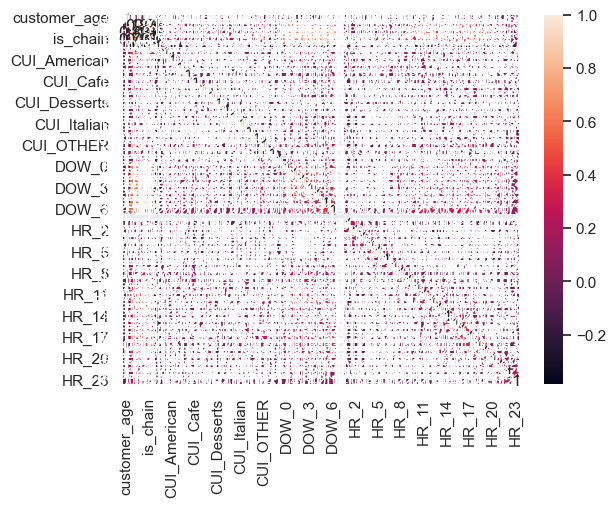

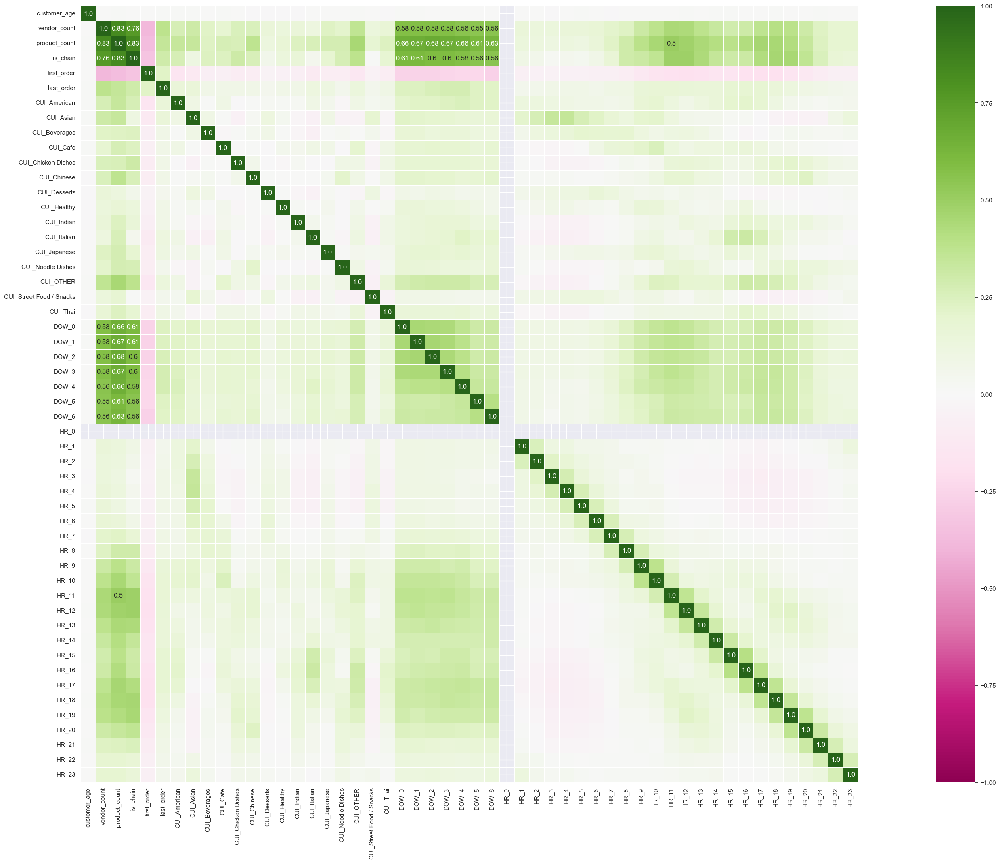

In [15]:
# Obtain correlation matrix. 
corr = data[metric_features].corr(method="pearson")

# Plot heatmap of the correlation matrix
sns.heatmap(data=corr, annot=True, )




corr = data[metric_features].corr(method="pearson")

##########
## 1. Round the values of the correlation matrix to 2 decimal places.
##    Hint: use .round()
corr = data[metric_features].corr(method="pearson").round(2)




mask_annot = np.absolute(corr.values) >= 0.5 ## What does this look like?
annot = np.where(mask_annot, corr.values, np.full(corr.shape,"")) # Try to understand what this np.where() does



fig = plt.figure(figsize=(50, 25))


##########
## 3a. Adjust minimum, maximum, and center values of the color scale 
##     Why? HINT: What are the range of values you expect with correlations?
## 3b. Show cells as squares, add line borders for aesthetics
## 3c. Choose better colormap: Why?
##########


# Plot heatmap of the correlation matrix
sns.heatmap(data=corr, 
            annot=annot, # Specify custom annotation
            fmt='s', # The annotation matrix now has strings, so we need to explicitly say this
            
            ########## 3a.
            vmin=-1, vmax=1, center=0,
            ########## 3b.
            square=True, linewidths=.5,
            ########## 3c.
            cmap='PiYG'
    
           )

## Once you are happy, save this as an image
plt.savefig(os.path.join('..', 'figures', 'eda', 'correlation_matrix.png'), dpi=200)

plt.show()



DOW_0    17720
DOW_1    18091
DOW_2    18836
DOW_3    19743
DOW_4    21607
DOW_5    20813
DOW_6    22453
dtype: int64


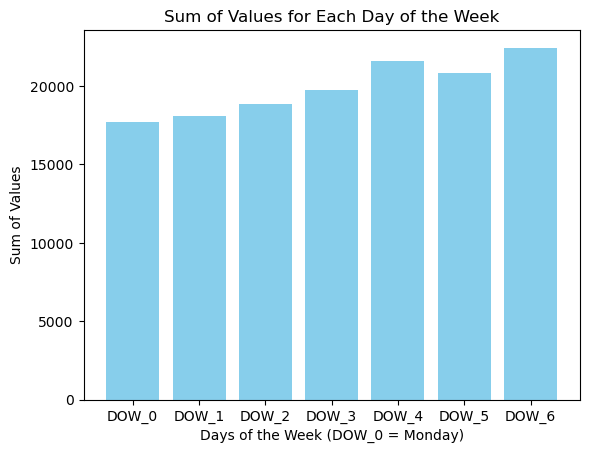

In [14]:
# Step 1: Sum the values of the columns that represent days of the week
day_columns = ['DOW_0', 'DOW_1', 'DOW_2', 'DOW_3', 'DOW_4', 'DOW_5', 'DOW_6']
day_column_sums = data[day_columns].sum()
print(day_column_sums)

# Step 2: Plot the bar chart of column sums
plt.bar(day_columns, day_column_sums, color='skyblue')
plt.title('Sum of Values for Each Day of the Week')
plt.xlabel('Days of the Week (DOW_0 = Monday)')
plt.ylabel('Sum of Values')
plt.show()

In [16]:
#create column of total money spent
data['Total_CUI'] = data.loc[:, 'CUI_American':'CUI_OTHER'].sum(axis=1)

#create column of total orders
data['Total_Orders'] = data.loc[:, 'DOW_0':'DOW_6'].sum(axis=1)




In [18]:
#Redo graphs
metric_features_2 = ['customer_age', 'vendor_count', 'product_count','is_chain', 'first_order', 'last_order', 'Total_CUI', 'Total_Orders']
metric_features_2




['customer_age',
 'vendor_count',
 'product_count',
 'is_chain',
 'first_order',
 'last_order',
 'Total_CUI',
 'Total_Orders']

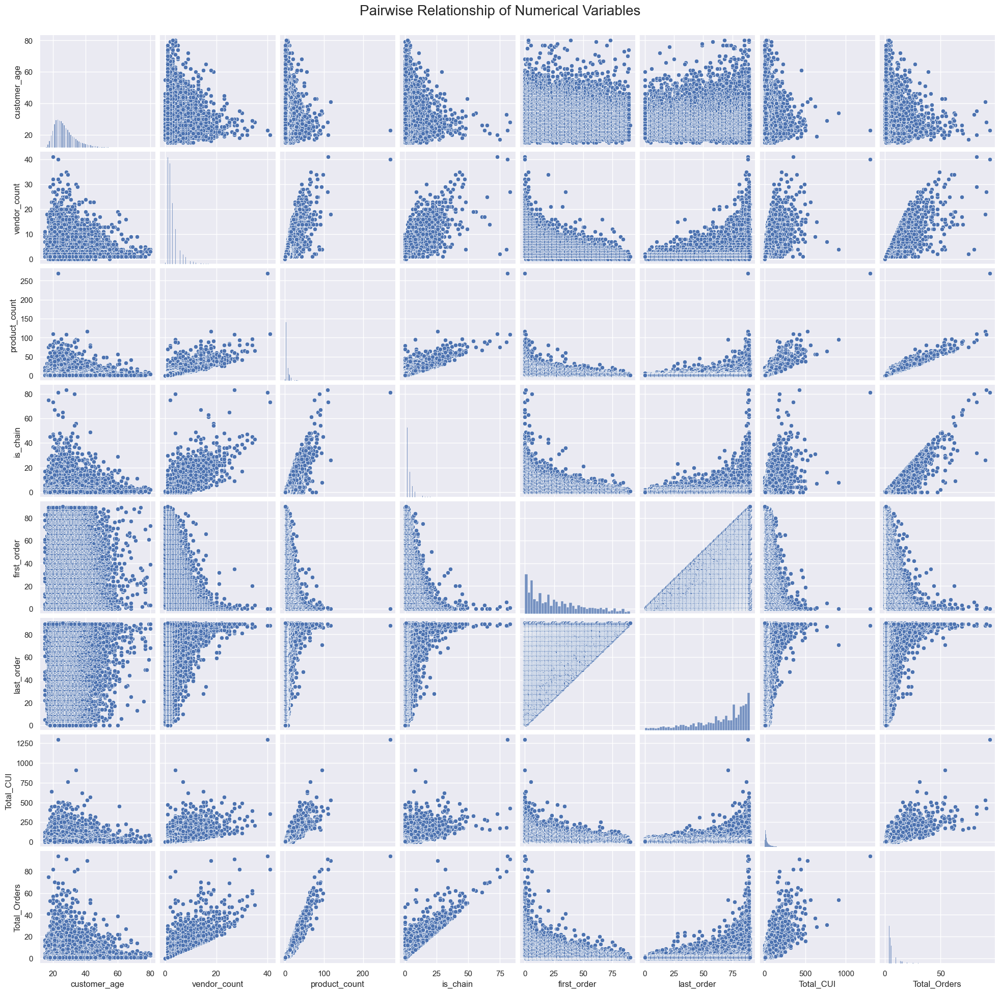

In [20]:
# Pairwise Relationship of Numerical Variables
sns.set()

# Setting pairplot
sns.pairplot(data[metric_features_2], diag_kind="hist")

# Layout
plt.subplots_adjust(top=0.95)
plt.suptitle("Pairwise Relationship of Numerical Variables", fontsize=20)

# if the eda directory is not present then create it first
if not os.path.exists(os.path.join('..', 'figures', 'eda')):
    os.makedirs(os.path.join('..', 'figures', 'eda'))
    
plt.savefig(os.path.join('..', 'figures', 'eda', 'pairwise_numeric_scatterplots.png'), dpi=200)
plt.show()

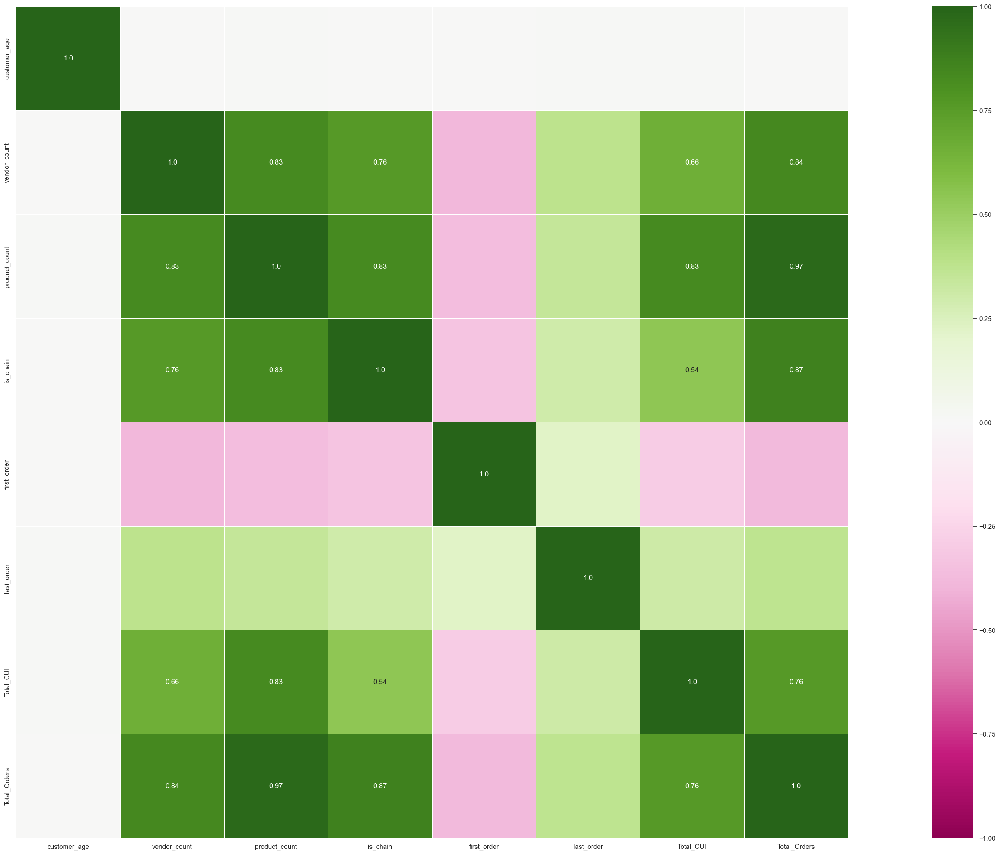

In [22]:
corr = data[metric_features_2].corr(method="pearson").round(2)




mask_annot = np.absolute(corr.values) >= 0.5 ## What does this look like?
annot = np.where(mask_annot, corr.values, np.full(corr.shape,"")) # Try to understand what this np.where() does



fig = plt.figure(figsize=(50, 25))


##########
## 3a. Adjust minimum, maximum, and center values of the color scale 
##     Why? HINT: What are the range of values you expect with correlations?
## 3b. Show cells as squares, add line borders for aesthetics
## 3c. Choose better colormap: Why?
##########


# Plot heatmap of the correlation matrix
sns.heatmap(data=corr, 
            annot=annot, # Specify custom annotation
            fmt='s', # The annotation matrix now has strings, so we need to explicitly say this
            
            ########## 3a.
            vmin=-1, vmax=1, center=0,
            ########## 3b.
            square=True, linewidths=.5,
            ########## 3c.
            cmap='PiYG'
    
           )

## Once you are happy, save this as an image
plt.savefig(os.path.join('..', 'figures', 'eda', 'correlation_matrix.png'), dpi=200)

plt.show()

In [25]:
plt.bar(data['Total_CUI'], color='skyblue')
plt.title('Sales by Product')
plt.xlabel('Product')
plt.ylabel('Sales')
plt.show()

SyntaxError: invalid syntax (487289373.py, line 1)